In [2]:
# 1. Importing Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
from sklearn.preprocessing import OneHotEncoder 
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.decomposition import PCA
from sklearn.neighbors import KNeighborsRegressor

%matplotlib inline

C:\Users\DELL\AppData\Local\Temp\ipykernel_6564\3545873155.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [3]:
#2. Loading Dataset
df=pd.read_csv("Capstone Project1/Property_data.csv")

In [4]:
#Checking the Shape of the dataframe
df.shape

(1460, 81)

In [239]:
# So the dataframe contains 1460 rows and 81 columns. Now to access the entire rows and columns
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [559]:
df.head()

,PropertyID,PropertyClass,PropertyZone,PropertyFrontage,PropertySize,Street,Alley,PropertyShape,Elevation,Amenities,Orientation,Grade,Neighborhood,Condition1,Condition2,BldgType,PropertyStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Roof1Material,Roof2Material,ExteriorCladdingType,ExteriorCladdingArea,ExterQual,ExterCond,PropertyFooting,BsmntFinish,BsmntMaintenance,BsmntVisibility,BsmntFinRat1,BsmntFinSty1,BsmntFinQual1,BsmtFinSF2,BsmtUnfSF,BsmntSqFtage,Heating,HeatingEfficiency,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,Bath1,Bath2,BedroomUpLev,KitchenUpLev,KitchenQual,CntRmsUpLev,Functional,CntFireplaces,QualFireplace,BasementType,BasementYrBlt,BasementFinish,BasementCars,BasementSqFootage,BasementQual,BasementCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,BoundaryFeatures,AddFeatures,AddVal,SaleMon,SaleYr,SaleType,SaleCondn,PropPrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [560]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   PropertyID            1460 non-null   int64  
 1   PropertyClass         1460 non-null   int64  
 2   PropertyZone          1460 non-null   object 
 3   PropertyFrontage      1201 non-null   float64
 4   PropertySize          1460 non-null   int64  
 5   Street                1460 non-null   object 
 6   Alley                 91 non-null     object 
 7   PropertyShape         1460 non-null   object 
 8   Elevation             1460 non-null   object 
 9   Amenities             1460 non-null   object 
 10  Orientation           1460 non-null   object 
 11  Grade                 1460 non-null   object 
 12  Neighborhood          1460 non-null   object 
 13  Condition1            1460 non-null   object 
 14  Condition2            1460 non-null   object 
 15  BldgType             

In [514]:
df.describe()

,PropertyID,PropertyClass,PropertyFrontage,PropertySize,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExteriorCladdingArea,BsmntFinSty1,BsmtFinSF2,BsmtUnfSF,BsmntSqFtage,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,Bath1,Bath2,BedroomUpLev,KitchenUpLev,CntRmsUpLev,CntFireplaces,BasementYrBlt,BasementCars,BasementSqFootage,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,AddVal,SaleMon,SaleYr,PropPrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [561]:
#Checking the Null Values
df.isnull().sum()

PropertyID                 0
PropertyClass              0
PropertyZone               0
PropertyFrontage         259
PropertySize               0
Street                     0
Alley                   1369
PropertyShape              0
Elevation                  0
Amenities                  0
Orientation                0
Grade                      0
Neighborhood               0
Condition1                 0
Condition2                 0
BldgType                   0
PropertyStyle              0
OverallQual                0
OverallCond                0
YearBuilt                  0
YearRemodAdd               0
RoofStyle                  0
RoofMatl                   0
Roof1Material              0
Roof2Material              0
ExteriorCladdingType     872
ExteriorCladdingArea       8
ExterQual                  0
ExterCond                  0
PropertyFooting            0
BsmntFinish               37
BsmntMaintenance          37
BsmntVisibility           38
BsmntFinRat1              37
BsmntFinSty1  

In [5]:
# So we find a lot of Null Values missing in 'Alley' i.e 1369, 'PoolQC'is 1453, 'BoundaryFeature' is 1179, 'AddFeatures' is 1406
#While very less NullValues in BasementCond, BasementType,Electrical,etc. 
#So 1st of all we willfind the percentage of thesenull values
df_missing = df.isnull().sum()/df.shape[0]*100
df_missing

PropertyID           0.000000
PropertyClass        0.000000
PropertyZone         0.000000
PropertyFrontage    17.739726
PropertySize         0.000000
                      ...    
SaleMon              0.000000
SaleYr               0.000000
SaleType             0.000000
SaleCondn            0.000000
PropPrice            0.000000
Length: 81, dtype: float64

**So it is seen that a lot of missing Value percentages are avaibalbe in
PoolQC	99.520548% missing value,
AddFeatures	96.301370% missing value,
Alley	93.767123% missing value,
BoundaryFeatures	80.753425% missing value,
ExteriorCladdingType	59.726027% missing value,
QualFireplace	47.26027%missing value,
PropertyFrontage	17.739726% missing value**

In [6]:
#Finding the missing values which are greater than 80%
df_miss_gre_80 = df_missing[df_missing>80]
df_miss_gre_80

Alley               93.767123
PoolQC              99.520548
BoundaryFeatures    80.753425
AddFeatures         96.301370
dtype: float64

**Now Data Cleaning or Data Preparation
 Reading Data Dictionary and Filling Missing Values**

In [7]:
#Now dropping the features which are having greater than 80% missing values
df1 = df.drop(['Alley','PoolQC','BoundaryFeatures','AddFeatures'],axis=1)

In [8]:
#Now checking the shape of the dataframe
df1.shape

(1460, 77)

In [9]:
#Finding the numerical values features list
df1_numerical = df1.select_dtypes(include=['int64','float64'])
df1_numerical.columns

Index(['PropertyID', 'PropertyClass', 'PropertyFrontage', 'PropertySize',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'ExteriorCladdingArea', 'BsmntFinSty1', 'BsmtFinSF2', 'BsmtUnfSF',
       'BsmntSqFtage', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea',
       'BsmtFullBath', 'BsmtHalfBath', 'Bath1', 'Bath2', 'BedroomUpLev',
       'KitchenUpLev', 'CntRmsUpLev', 'CntFireplaces', 'BasementYrBlt',
       'BasementCars', 'BasementSqFootage', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'AddVal',
       'SaleMon', 'SaleYr', 'PropPrice'],
      dtype='object')

In [10]:
#Dropping the "PropertyID" Column as it will not impact in our calculations
df1_numerical = df1_numerical.drop(columns='PropertyID')

In [11]:
#After dropping again checking the features names
df1_numerical.columns

Index(['PropertyClass', 'PropertyFrontage', 'PropertySize', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'ExteriorCladdingArea',
       'BsmntFinSty1', 'BsmtFinSF2', 'BsmtUnfSF', 'BsmntSqFtage', '1stFlrSF',
       '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath',
       'Bath1', 'Bath2', 'BedroomUpLev', 'KitchenUpLev', 'CntRmsUpLev',
       'CntFireplaces', 'BasementYrBlt', 'BasementCars', 'BasementSqFootage',
       'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch',
       'ScreenPorch', 'PoolArea', 'AddVal', 'SaleMon', 'SaleYr', 'PropPrice'],
      dtype='object')

In [12]:
#Now in these numerical features finding the list of missing values and their percentages
df1_numerical_missing = df1_numerical.isnull().sum()/df1_numerical.shape[0]*100
df1_numerical_missing

PropertyClass            0.000000
PropertyFrontage        17.739726
PropertySize             0.000000
OverallQual              0.000000
OverallCond              0.000000
YearBuilt                0.000000
YearRemodAdd             0.000000
ExteriorCladdingArea     0.547945
BsmntFinSty1             0.000000
BsmtFinSF2               0.000000
BsmtUnfSF                0.000000
BsmntSqFtage             0.000000
1stFlrSF                 0.000000
2ndFlrSF                 0.000000
LowQualFinSF             0.000000
GrLivArea                0.000000
BsmtFullBath             0.000000
BsmtHalfBath             0.000000
Bath1                    0.000000
Bath2                    0.000000
BedroomUpLev             0.000000
KitchenUpLev             0.000000
CntRmsUpLev              0.000000
CntFireplaces            0.000000
BasementYrBlt            5.547945
BasementCars             0.000000
BasementSqFootage        0.000000
WoodDeckSF               0.000000
OpenPorchSF              0.000000
EnclosedPorch 

In [13]:
df1_numerical_missing_gre_0 = df1_numerical_missing[df1_numerical_missing>0]
df1_numerical_missing_gre_0

PropertyFrontage        17.739726
ExteriorCladdingArea     0.547945
BasementYrBlt            5.547945
dtype: float64

In [14]:
#Now we find that only three numerical features are having missing values and we will impute or fill these missing values
# Imputing for PropertyFrontage (Linear feet of street connected to property)
df1['PropertyFrontage'] = df1['PropertyFrontage'].fillna(0.0)
## Imputing for ExteriorCladdingArea (Masonry veneer type)
df1['ExteriorCladdingArea'] = df1['ExteriorCladdingArea'].fillna(0)
 ## Imputing for BasementYrBlt (Year garage was built)
df1['BasementYrBlt'] = df1['BasementYrBlt'].fillna(0)


In [15]:
#Checking if the numerical features stillcontains any null values
df1_numerical_clean=df1.select_dtypes(include=['int64','float64'])
df1_numerical_clean.isnull().sum().sum()

0

In [660]:
#Now for the Categorical Features
df1_categorical = df1.select_dtypes(include=['object'])
df1_categorical

,PropertyZone,Street,PropertyShape,Elevation,Amenities,Orientation,Grade,Neighborhood,Condition1,Condition2,BldgType,PropertyStyle,RoofStyle,RoofMatl,Roof1Material,Roof2Material,ExteriorCladdingType,ExterQual,ExterCond,PropertyFooting,BsmntFinish,BsmntMaintenance,BsmntVisibility,BsmntFinRat1,BsmntFinQual1,Heating,HeatingEfficiency,CentralAir,Electrical,KitchenQual,Functional,QualFireplace,BasementType,BasementFinish,BasementQual,BasementCond,PavedDrive,SaleType,SaleCondn
0,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,NaN,Attchd,RFn,TA,TA,Y,WD,Normal
1,RL,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,Gable,CompShg,MetalSd,MetalSd,NaN,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
2,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
3,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,Gable,CompShg,Wd Sdng,Wd Shng,NaN,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Gd,Detchd,Unf,TA,TA,Y,WD,Abnorml
4,RL,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
5,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,Gable,CompShg,VinylSd,VinylSd,NaN,TA,TA,Wood,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,NaN,Attchd,Unf,TA,TA,Y,WD,Normal
6,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,Stone,Gd,TA,PConc,Ex,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Gd,Attchd,RFn,TA,TA,Y,WD,Normal
7,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,Gable,CompShg,HdBoard,HdBoard,Stone,TA,TA,CBlock,Gd,TA,Mn,ALQ,BLQ,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
8,RM,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,Gable,CompShg,BrkFace,Wd Shng,NaN,TA,TA,BrkTil,TA,TA,No,Unf,Unf,GasA,Gd,Y,FuseF,TA,Min1,TA,Detchd,Unf,Fa,TA,Y,WD,Abnorml
9,RL,Pave,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,Gable,CompShg,MetalSd,MetalSd,NaN,TA,TA,BrkTil,TA,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,Gd,TA,Y,WD,Normal


In [661]:
#Categorical Features List
df1_categorical.columns

Index(['PropertyZone', 'Street', 'PropertyShape', 'Elevation', 'Amenities',
       'Orientation', 'Grade', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'PropertyStyle', 'RoofStyle', 'RoofMatl', 'Roof1Material',
       'Roof2Material', 'ExteriorCladdingType', 'ExterQual', 'ExterCond',
       'PropertyFooting', 'BsmntFinish', 'BsmntMaintenance', 'BsmntVisibility',
       'BsmntFinRat1', 'BsmntFinQual1', 'Heating', 'HeatingEfficiency',
       'CentralAir', 'Electrical', 'KitchenQual', 'Functional',
       'QualFireplace', 'BasementType', 'BasementFinish', 'BasementQual',
       'BasementCond', 'PavedDrive', 'SaleType', 'SaleCondn'],
      dtype='object')

In [603]:
#List of Categorical Features Missing Values
df1_categorical.isnull().sum()

PropertyZone              0
Street                    0
PropertyShape             0
Elevation                 0
Amenities                 0
Orientation               0
Grade                     0
Neighborhood              0
Condition1                0
Condition2                0
BldgType                  0
PropertyStyle             0
RoofStyle                 0
RoofMatl                  0
Roof1Material             0
Roof2Material             0
ExteriorCladdingType    872
ExterQual                 0
ExterCond                 0
PropertyFooting           0
BsmntFinish              37
BsmntMaintenance         37
BsmntVisibility          38
BsmntFinRat1             37
BsmntFinQual1            38
Heating                   0
HeatingEfficiency         0
CentralAir                0
Electrical                1
KitchenQual               0
Functional                0
QualFireplace           690
BasementType             81
BasementFinish           81
BasementQual             81
BasementCond        

In [662]:
#Finding Categorical Features Percentage missing values
df1_categorical_missing = df1_categorical.isnull().sum()/df1_categorical.shape[0]*100
df1_categorical_missing

PropertyZone             0.000000
Street                   0.000000
PropertyShape            0.000000
Elevation                0.000000
Amenities                0.000000
Orientation              0.000000
Grade                    0.000000
Neighborhood             0.000000
Condition1               0.000000
Condition2               0.000000
BldgType                 0.000000
PropertyStyle            0.000000
RoofStyle                0.000000
RoofMatl                 0.000000
Roof1Material            0.000000
Roof2Material            0.000000
ExteriorCladdingType    59.726027
ExterQual                0.000000
ExterCond                0.000000
PropertyFooting          0.000000
BsmntFinish              2.534247
BsmntMaintenance         2.534247
BsmntVisibility          2.602740
BsmntFinRat1             2.534247
BsmntFinQual1            2.602740
Heating                  0.000000
HeatingEfficiency        0.000000
CentralAir               0.000000
Electrical               0.068493
KitchenQual   

In [663]:
df1_categorical_missing_gre_0 = df1_categorical_missing[df1_categorical_missing>0]
df1_categorical_missing_gre_0

ExteriorCladdingType    59.726027
BsmntFinish              2.534247
BsmntMaintenance         2.534247
BsmntVisibility          2.602740
BsmntFinRat1             2.534247
BsmntFinQual1            2.602740
Electrical               0.068493
QualFireplace           47.260274
BasementType             5.547945
BasementFinish           5.547945
BasementQual             5.547945
BasementCond             5.547945
dtype: float64

In [611]:
df1['ExteriorCladdingType']

0       BrkFace
1           NaN
2       BrkFace
3           NaN
4       BrkFace
5           NaN
6         Stone
7         Stone
8           NaN
9           NaN
10          NaN
11        Stone
12          NaN
13        Stone
14      BrkFace
15          NaN
16      BrkFace
17          NaN
18          NaN
19          NaN
20      BrkFace
21          NaN
22      BrkFace
23          NaN
24          NaN
25        Stone
26          NaN
27        Stone
28          NaN
29          NaN
30          NaN
31          NaN
32          NaN
33          NaN
34      BrkFace
35        Stone
36          NaN
37      BrkFace
38          NaN
39          NaN
40      BrkFace
41          NaN
42          NaN
43          NaN
44          NaN
45      BrkFace
46          NaN
47          NaN
48          NaN
49          NaN
50          NaN
51          NaN
52          NaN
53          NaN
54          NaN
55      BrkFace
56      BrkFace
57          NaN
58      BrkFace
59          NaN
60          NaN
61          NaN
62      

In [610]:
#Checking the Specific Category unique feature values
df1['ExteriorCladdingType'].unique()

array(['BrkFace', nan, 'Stone', 'BrkCmn'], dtype=object)

In [664]:
# filling with most common class
df1_categorical_clean = df1_categorical.apply(lambda x: x.fillna(x.value_counts().index[0]))
df1_categorical_clean

,PropertyZone,Street,PropertyShape,Elevation,Amenities,Orientation,Grade,Neighborhood,Condition1,Condition2,BldgType,PropertyStyle,RoofStyle,RoofMatl,Roof1Material,Roof2Material,ExteriorCladdingType,ExterQual,ExterCond,PropertyFooting,BsmntFinish,BsmntMaintenance,BsmntVisibility,BsmntFinRat1,BsmntFinQual1,Heating,HeatingEfficiency,CentralAir,Electrical,KitchenQual,Functional,QualFireplace,BasementType,BasementFinish,BasementQual,BasementCond,PavedDrive,SaleType,SaleCondn
0,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Gd,Attchd,RFn,TA,TA,Y,WD,Normal
1,RL,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,Gable,CompShg,MetalSd,MetalSd,BrkFace,TA,TA,CBlock,Gd,TA,Gd,ALQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
2,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Mn,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
3,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,Gable,CompShg,Wd Sdng,Wd Shng,BrkFace,TA,TA,BrkTil,TA,Gd,No,ALQ,Unf,GasA,Gd,Y,SBrkr,Gd,Typ,Gd,Detchd,Unf,TA,TA,Y,WD,Abnorml
4,RL,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,Gd,TA,PConc,Gd,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
5,RL,Pave,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,Gable,CompShg,VinylSd,VinylSd,BrkFace,TA,TA,Wood,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,Gd,Attchd,Unf,TA,TA,Y,WD,Normal
6,RL,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,Stone,Gd,TA,PConc,Ex,TA,Av,GLQ,Unf,GasA,Ex,Y,SBrkr,Gd,Typ,Gd,Attchd,RFn,TA,TA,Y,WD,Normal
7,RL,Pave,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,Gable,CompShg,HdBoard,HdBoard,Stone,TA,TA,CBlock,Gd,TA,Mn,ALQ,BLQ,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,TA,TA,Y,WD,Normal
8,RM,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,Gable,CompShg,BrkFace,Wd Shng,BrkFace,TA,TA,BrkTil,TA,TA,No,Unf,Unf,GasA,Gd,Y,FuseF,TA,Min1,TA,Detchd,Unf,Fa,TA,Y,WD,Abnorml
9,RL,Pave,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,Gable,CompShg,MetalSd,MetalSd,BrkFace,TA,TA,BrkTil,TA,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,TA,Typ,TA,Attchd,RFn,Gd,TA,Y,WD,Normal


In [619]:
#Checking for any nullvalues in categorical features is left
df1_categorical_clean.isnull().sum()

PropertyZone            0
Street                  0
PropertyShape           0
Elevation               0
Amenities               0
Orientation             0
Grade                   0
Neighborhood            0
Condition1              0
Condition2              0
BldgType                0
PropertyStyle           0
RoofStyle               0
RoofMatl                0
Roof1Material           0
Roof2Material           0
ExteriorCladdingType    0
ExterQual               0
ExterCond               0
PropertyFooting         0
BsmntFinish             0
BsmntMaintenance        0
BsmntVisibility         0
BsmntFinRat1            0
BsmntFinQual1           0
Heating                 0
HeatingEfficiency       0
CentralAir              0
Electrical              0
KitchenQual             0
Functional              0
QualFireplace           0
BasementType            0
BasementFinish          0
BasementQual            0
BasementCond            0
PavedDrive              0
SaleType                0
SaleCondn   

In [665]:
df1_categorical_clean.shape

(1460, 39)

In [666]:
df1_numerical.shape

(1460, 37)

In [667]:
#Now joining the numerical cleaned dataframe and categorical clean dataframe
df2 = df1_numerical_clean.join(df1_categorical_clean)

In [668]:
#New dataframe shape
df2.shape

(1460, 77)

In [669]:
#Checking for null values if any
df2.isnull().sum()

PropertyID              0
PropertyClass           0
PropertyFrontage        0
PropertySize            0
OverallQual             0
OverallCond             0
YearBuilt               0
YearRemodAdd            0
ExteriorCladdingArea    0
BsmntFinSty1            0
BsmtFinSF2              0
BsmtUnfSF               0
BsmntSqFtage            0
1stFlrSF                0
2ndFlrSF                0
LowQualFinSF            0
GrLivArea               0
BsmtFullBath            0
BsmtHalfBath            0
Bath1                   0
Bath2                   0
BedroomUpLev            0
KitchenUpLev            0
CntRmsUpLev             0
CntFireplaces           0
BasementYrBlt           0
BasementCars            0
BasementSqFootage       0
WoodDeckSF              0
OpenPorchSF             0
EnclosedPorch           0
3SsnPorch               0
ScreenPorch             0
PoolArea                0
AddVal                  0
SaleMon                 0
SaleYr                  0
PropPrice               0
PropertyZone

In [636]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 77 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   PropertyID            1460 non-null   int64  
 1   PropertyClass         1460 non-null   int64  
 2   PropertyFrontage      1460 non-null   float64
 3   PropertySize          1460 non-null   int64  
 4   OverallQual           1460 non-null   int64  
 5   OverallCond           1460 non-null   int64  
 6   YearBuilt             1460 non-null   int64  
 7   YearRemodAdd          1460 non-null   int64  
 8   ExteriorCladdingArea  1460 non-null   float64
 9   BsmntFinSty1          1460 non-null   int64  
 10  BsmtFinSF2            1460 non-null   int64  
 11  BsmtUnfSF             1460 non-null   int64  
 12  BsmntSqFtage          1460 non-null   int64  
 13  1stFlrSF              1460 non-null   int64  
 14  2ndFlrSF              1460 non-null   int64  
 15  LowQualFinSF         

<Axes: >

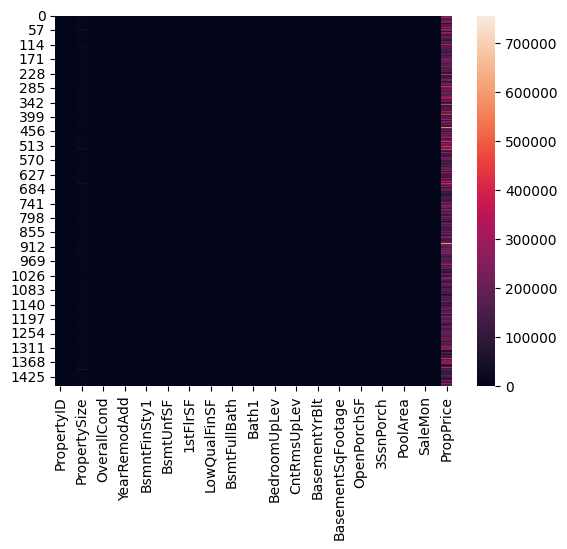

In [534]:
#So it is seen that it contains no missing values
sns.heatmap(df_num)

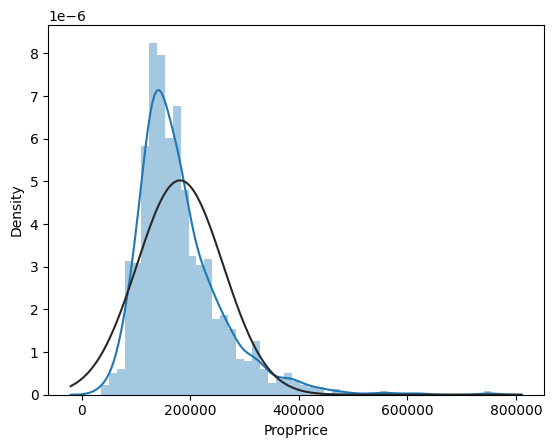

In [670]:
# Let us first visualize the spread of Target Variable 'PropPrice'
from scipy.stats import norm
sns.distplot(df2['PropPrice'], fit=norm)
plt.show()


The Property Price distribution is not normally distributed, it is a little positively skewed with some houses having really high Sale Price

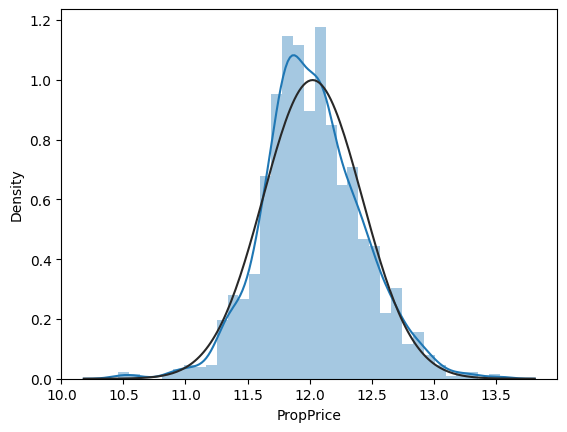

In [671]:
#Doing the log normal distribution for the right skewed data
df2['PropPrice'] = np.log(df2['PropPrice'])
sns.distplot(df2['PropPrice'], fit=norm)
plt.show()

Now the PropPrice feature is normally distributed

In [672]:
#Dropping the Property ID
df2 = df2.drop(columns='PropertyID')

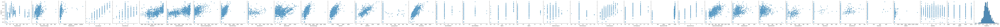

In [642]:
#EDA Part (Exploratory Data Analysis)
sns.pairplot(df2, y_vars='PropPrice',height=4, aspect=1, kind='scatter')

<Axes: >

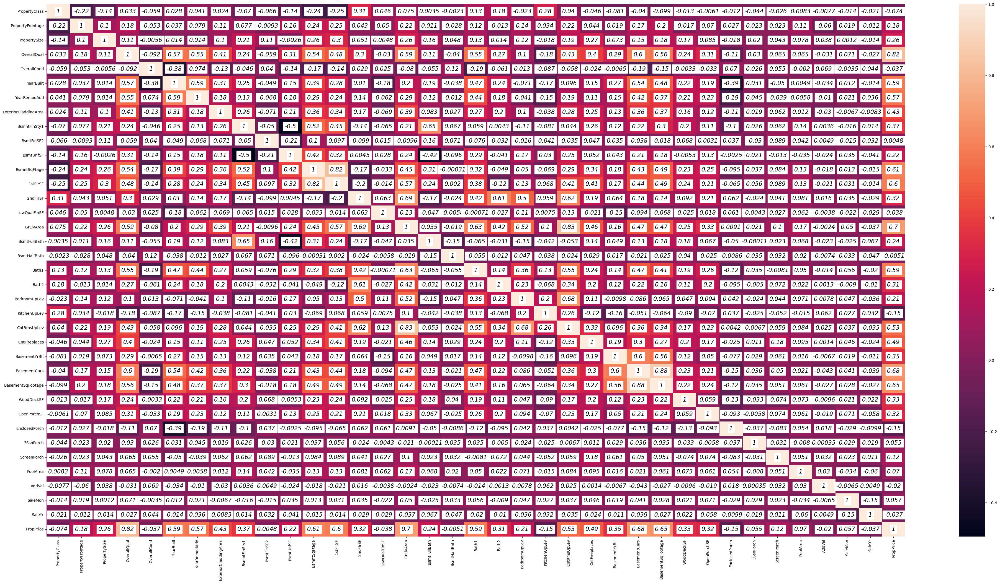

In [644]:
#Finding Correlation and checking the same by visualisation
plt.figure(figsize=(50, 25))
annot_kws={"fontsize":15,
           "fontstyle":'italic',
           "color":"k",
           "alpha":0.99,
           "rotation":"horizontal",
           "verticalalignment":"center",
           "backgroundcolor":"w"}
sns.heatmap(df2.corr(numeric_only=True),
            annot=True,annot_kws=annot_kws)

In [685]:
#Strongly Correlated are only Values
strong_corr_num = ['OverallQual', 'YearBuilt', 'YearRemodAdd','ExteriorCladdingArea','BsmntSqFtage', '1stFlrSF',
       'BsmtFullBath', 'BedroomUpLev','BasementYrBlt','WoodDeckSF']

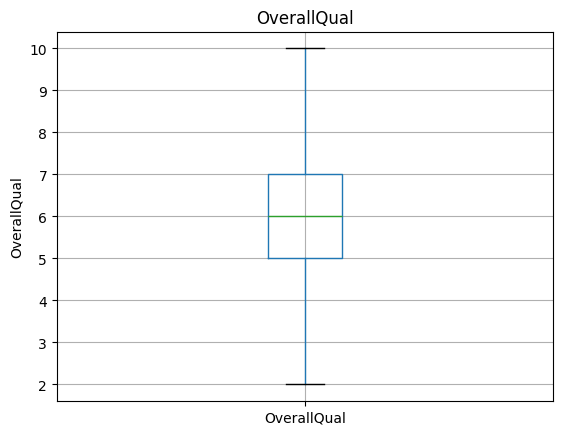

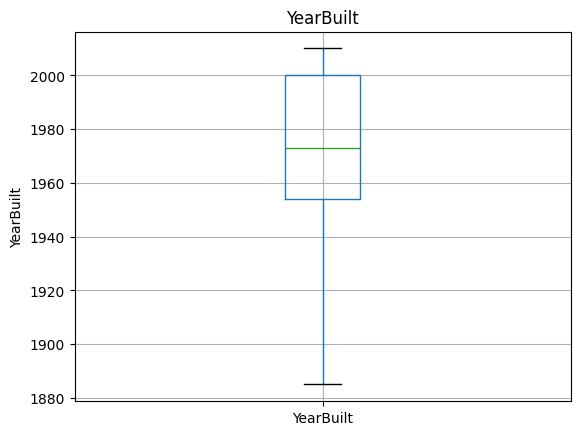

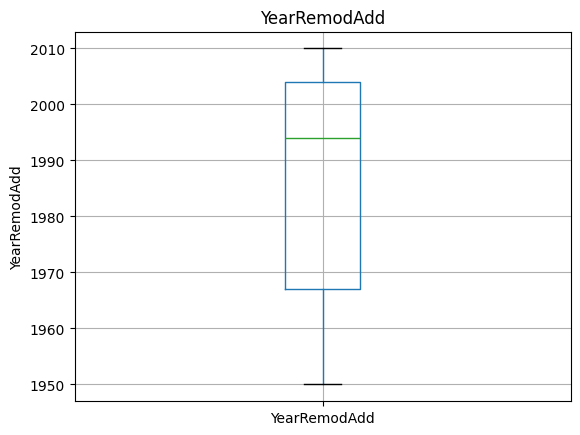

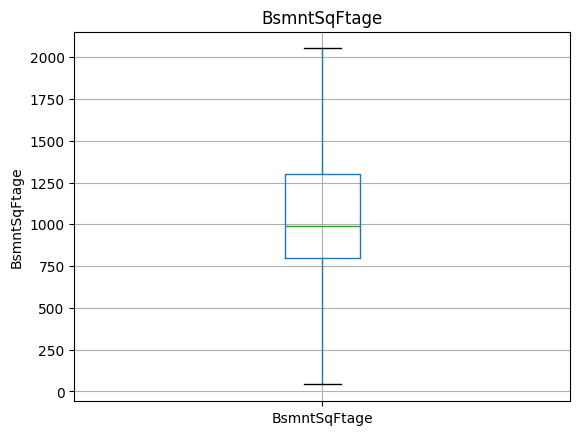

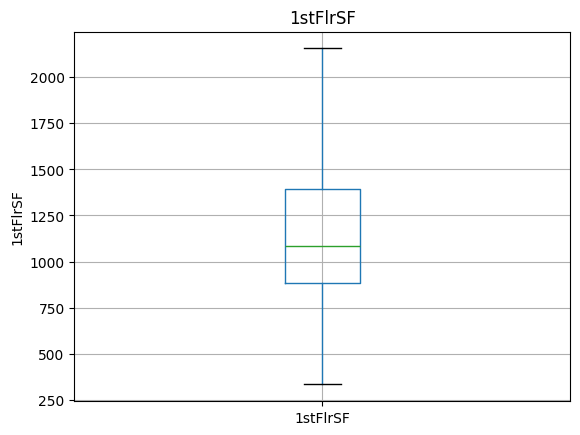

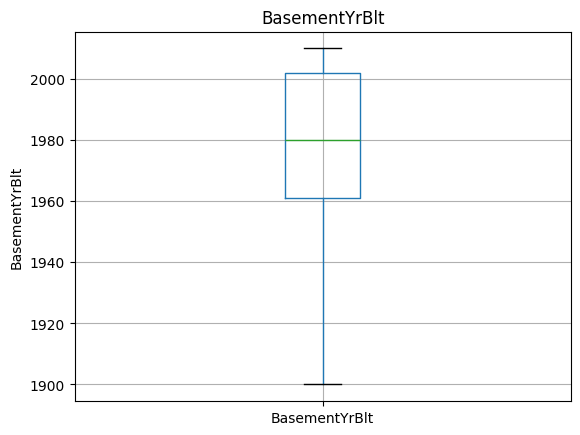

In [686]:
#Removing all the Outliers
for feature in strong_corr_num:
    q1=df2[feature].quantile(0.25)
    q3=df2[feature].quantile(0.75)
    iqr=q3-q1
    lower=q1-1.5*iqr
    upper=q3+1.5*iqr
    if df2[feature].any()<lower or df2[feature].any()>upper :
        df2[feature]=df2[feature].replace(df2[feature].mean())
        df2.boxplot(column=feature)
        plt.ylabel(feature)
        plt.title(feature)
        plt.show()

In [697]:
df1_categorical_clean.columns

Index(['PropertyZone', 'Street', 'PropertyShape', 'Elevation', 'Amenities',
       'Orientation', 'Grade', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'PropertyStyle', 'RoofStyle', 'RoofMatl', 'Roof1Material',
       'Roof2Material', 'ExteriorCladdingType', 'ExterQual', 'ExterCond',
       'PropertyFooting', 'BsmntFinish', 'BsmntMaintenance', 'BsmntVisibility',
       'BsmntFinRat1', 'BsmntFinQual1', 'Heating', 'HeatingEfficiency',
       'CentralAir', 'Electrical', 'KitchenQual', 'Functional',
       'QualFireplace', 'BasementType', 'BasementFinish', 'BasementQual',
       'BasementCond', 'PavedDrive', 'SaleType', 'SaleCondn'],
      dtype='object')

In [701]:
df1_categorical_clean['PropertyZone'].unique()

array(['RL', 'RM', 'C (all)', 'FV', 'RH'], dtype=object)

In [702]:
df1_categorical_clean['PropertyZone'].unique().size

5

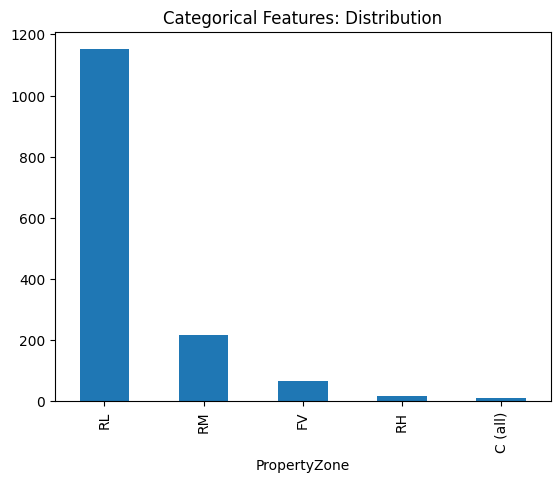

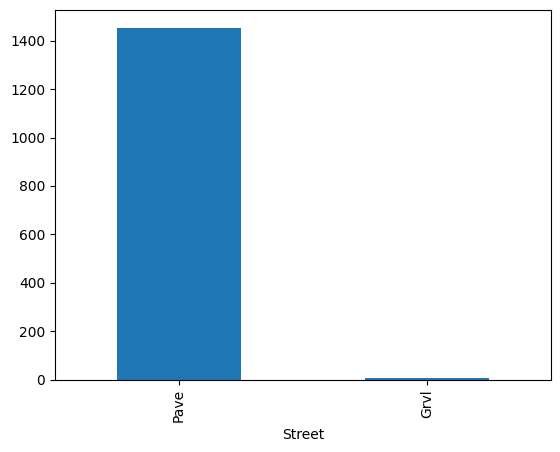

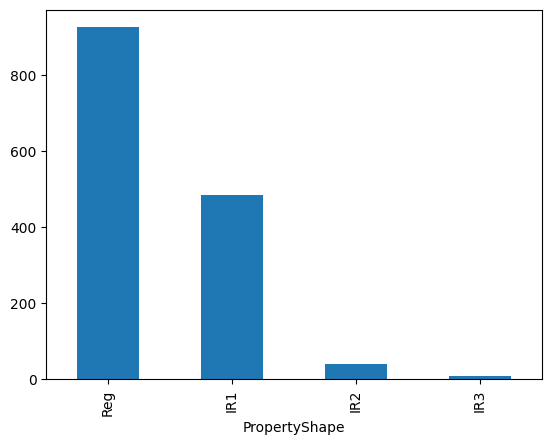

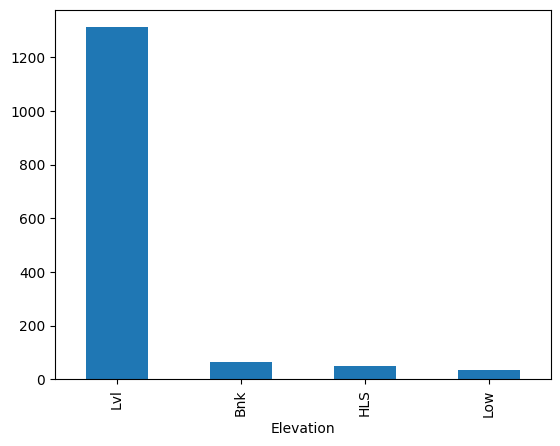

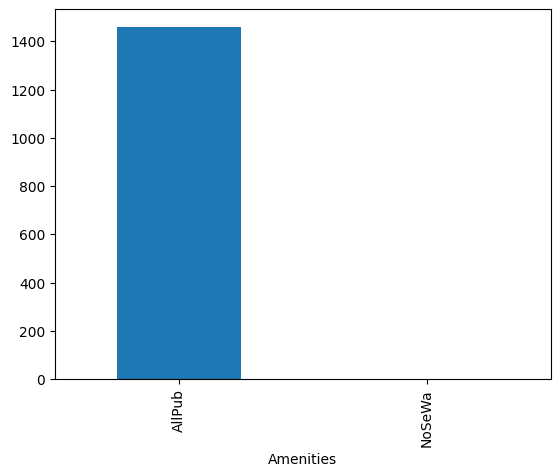

...

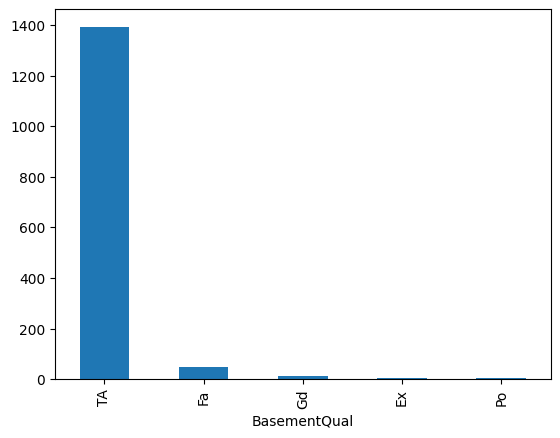

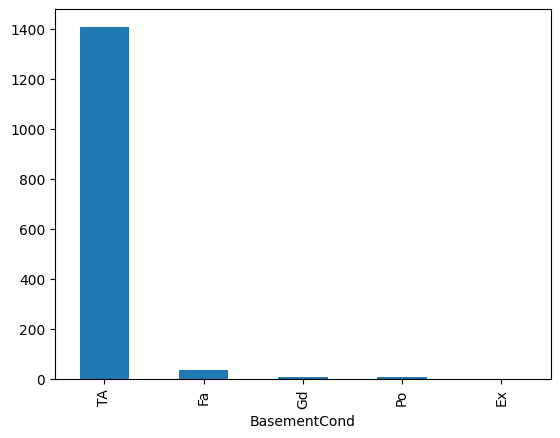

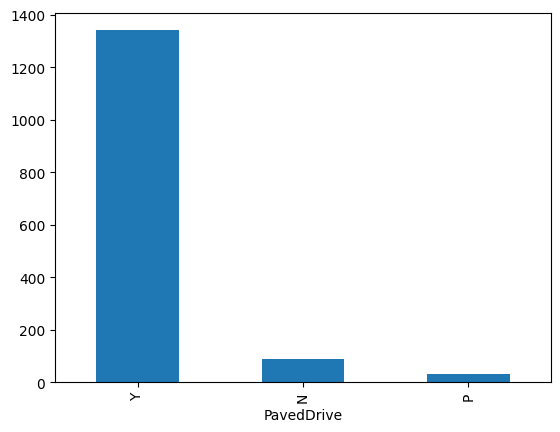

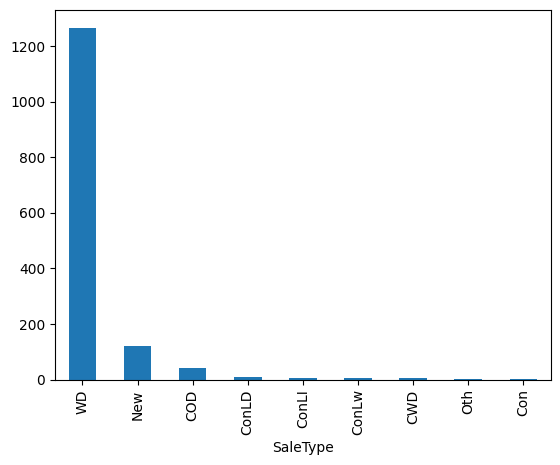

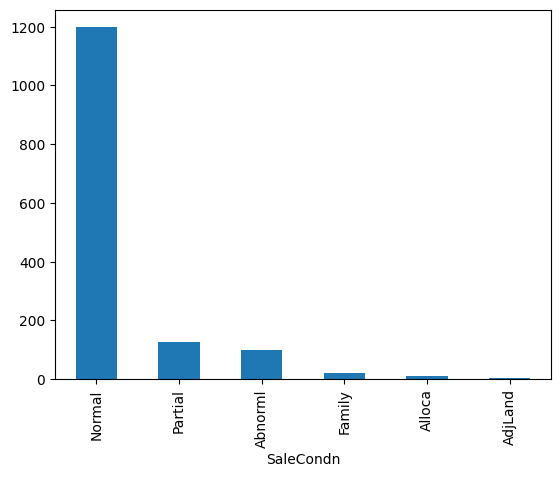

In [753]:
#Plotting the Categorical Features: Distribution


plt.title('Categorical Features: Distribution')
for col in df1_categorical_clean:
    df1_categorical_clean[col].value_counts().plot(kind='bar')
    plt.show()

In [760]:
#df1_categorical_clean.columns
print("Categorical variables:")
print(df1_categorical_clean.columns)
print('No. of. categorical features: ', 
      len(df1_categorical_clean.columns))

Categorical variables:
Index(['PropertyZone', 'Street', 'PropertyShape', 'Elevation', 'Amenities',
       'Orientation', 'Grade', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'PropertyStyle', 'RoofStyle', 'RoofMatl', 'Roof1Material',
       'Roof2Material', 'ExteriorCladdingType', 'ExterQual', 'ExterCond',
       'PropertyFooting', 'BsmntFinish', 'BsmntMaintenance', 'BsmntVisibility',
       'BsmntFinRat1', 'BsmntFinQual1', 'Heating', 'HeatingEfficiency',
       'CentralAir', 'Electrical', 'KitchenQual', 'Functional',
       'QualFireplace', 'BasementType', 'BasementFinish', 'BasementQual',
       'BasementCond', 'PavedDrive', 'SaleType', 'SaleCondn'],
      dtype='object')
No. of. categorical features:  39


In [763]:
#Applying One hot encoding for the categorical data
df2_get_dummies = pd.get_dummies(df1_categorical_clean[['PropertyZone', 'Street', 'PropertyShape', 'Elevation', 'Amenities',
       'Orientation', 'Grade', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'PropertyStyle', 'RoofStyle', 'RoofMatl', 'Roof1Material',
       'Roof2Material', 'ExteriorCladdingType', 'ExterQual', 'ExterCond',
       'PropertyFooting', 'BsmntFinish', 'BsmntMaintenance', 'BsmntVisibility',
       'BsmntFinRat1', 'BsmntFinQual1', 'Heating', 'HeatingEfficiency',
       'CentralAir', 'Electrical', 'KitchenQual', 'Functional',
       'QualFireplace', 'BasementType', 'BasementFinish', 'BasementQual',
       'BasementCond', 'PavedDrive', 'SaleType', 'SaleCondn']])
    

In [764]:
df2_get_dummies=df2_get_dummies.applymap(lambda x: 1 if x==True else 0 if x == False else x)

In [765]:
df2_get_dummies

,PropertyZone_C (all),PropertyZone_FV,PropertyZone_RH,PropertyZone_RL,PropertyZone_RM,Street_Grvl,Street_Pave,PropertyShape_IR1,PropertyShape_IR2,PropertyShape_IR3,PropertyShape_Reg,Elevation_Bnk,Elevation_HLS,Elevation_Low,Elevation_Lvl,Amenities_AllPub,Amenities_NoSeWa,Orientation_Corner,Orientation_CulDSac,Orientation_FR2,Orientation_FR3,Orientation_Inside,Grade_Gtl,Grade_Mod,Grade_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,PropertyStyle_1.5Fin,PropertyStyle_1.5Unf,PropertyStyle_1Story,PropertyStyle_2.5Fin,PropertyStyle_2.5Unf,PropertyStyle_2Story,PropertyStyle_SFoyer,PropertyStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Roof1Material_AsbShng,Roof1Material_AsphShn,Roof1Material_BrkComm,Roof1Material_BrkFace,Roof1Material_CBlock,Roof1Material_CemntBd,Roof1Material_HdBoard,Roof1Material_ImStucc,Roof1Material_MetalSd,Roof1Material_Plywood,Roof1Material_Stone,Roof1Material_Stucco,Roof1Material_VinylSd,Roof1Material_Wd Sdng,Roof1Material_WdShing,Roof2Material_AsbShng,Roof2Material_AsphShn,Roof2Material_Brk Cmn,Roof2Material_BrkFace,Roof2Material_CBlock,Roof2Material_CmentBd,Roof2Material_HdBoard,Roof2Material_ImStucc,Roof2Material_MetalSd,Roof2Material_Other,Roof2Material_Plywood,Roof2Material_Stone,Roof2Material_Stucco,Roof2Material_VinylSd,Roof2Material_Wd Sdng,Roof2Material_Wd Shng,ExteriorCladdingType_BrkCmn,ExteriorCladdingType_BrkFace,ExteriorCladdingType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,PropertyFooting_BrkTil,PropertyFooting_CBlock,PropertyFooting_PConc,PropertyFooting_Slab,PropertyFooting_Stone,PropertyFooting_Wood,BsmntFinish_Ex,BsmntFinish_Fa,BsmntFinish_Gd,BsmntFinish_TA,BsmntMaintenance_Fa,BsmntMaintenance_Gd,BsmntMaintenance_Po,BsmntMaintenance_TA,BsmntVisibility_Av,BsmntVisibility_Gd,BsmntVisibility_Mn,BsmntVisibility_No,BsmntFinRat1_ALQ,BsmntFinRat1_BLQ,BsmntFinRat1_GLQ,BsmntFinRat1_LwQ,BsmntFinRat1_Rec,BsmntFinRat1_Unf,BsmntFinQual1_ALQ,BsmntFinQual1_BLQ,BsmntFinQual1_GLQ,BsmntFinQual1_LwQ,BsmntFinQual1_Rec,BsmntFinQual1_Unf,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingEfficiency_Ex,HeatingEfficiency_Fa,HeatingEfficiency_Gd,HeatingEfficiency_Po,HeatingEfficiency_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,QualFireplace_Ex,QualFireplace_Fa,QualFireplace_Gd,QualFireplace_Po,QualFireplace_TA,BasementType_2Types,BasementType_Attchd,BasementType_Basment,BasementType_BuiltIn,BasementType_CarPort,BasementType_Detchd,BasementFinish_Fin,BasementFinish_RFn,BasementFinish_Unf,BasementQual_Ex,BasementQual_Fa,BasementQual_Gd,BasementQual_Po,BasementQual_TA,BasementCond_Ex,BasementCond_Fa,BasementCond_Gd,BasementCond_Po,BasementCond_TA,PavedDrive_N,PavedDrive_P,

In [766]:
df2_get_dummies.shape

(1460, 238)

In [768]:
#Again joining the df2_get_dummies dataframe with the df1_numerical_clean dataframe
df2 = df1_numerical_clean.join(df2_get_dummies)
df2.head()

,PropertyID,PropertyClass,PropertyFrontage,PropertySize,OverallQual,OverallCond,YearBuilt,YearRemodAdd,ExteriorCladdingArea,BsmntFinSty1,BsmtFinSF2,BsmtUnfSF,BsmntSqFtage,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,Bath1,Bath2,BedroomUpLev,KitchenUpLev,CntRmsUpLev,CntFireplaces,BasementYrBlt,BasementCars,BasementSqFootage,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,AddVal,SaleMon,SaleYr,PropPrice,PropertyZone_C (all),PropertyZone_FV,PropertyZone_RH,PropertyZone_RL,PropertyZone_RM,Street_Grvl,Street_Pave,PropertyShape_IR1,PropertyShape_IR2,PropertyShape_IR3,PropertyShape_Reg,Elevation_Bnk,Elevation_HLS,Elevation_Low,Elevation_Lvl,Amenities_AllPub,Amenities_NoSeWa,Orientation_Corner,Orientation_CulDSac,Orientation_FR2,Orientation_FR3,Orientation_Inside,Grade_Gtl,Grade_Mod,Grade_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,PropertyStyle_1.5Fin,PropertyStyle_1.5Unf,PropertyStyle_1Story,PropertyStyle_2.5Fin,PropertyStyle_2.5Unf,PropertyStyle_2Story,PropertyStyle_SFoyer,PropertyStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Roof1Material_AsbShng,Roof1Material_AsphShn,Roof1Material_BrkComm,Roof1Material_BrkFace,Roof1Material_CBlock,Roof1Material_CemntBd,Roof1Material_HdBoard,Roof1Material_ImStucc,Roof1Material_MetalSd,Roof1Material_Plywood,Roof1Material_Stone,Roof1Material_Stucco,Roof1Material_VinylSd,Roof1Material_Wd Sdng,Roof1Material_WdShing,Roof2Material_AsbShng,Roof2Material_AsphShn,Roof2Material_Brk Cmn,Roof2Material_BrkFace,Roof2Material_CBlock,Roof2Material_CmentBd,Roof2Material_HdBoard,Roof2Material_ImStucc,Roof2Material_MetalSd,Roof2Material_Other,Roof2Material_Plywood,Roof2Material_Stone,Roof2Material_Stucco,Roof2Material_VinylSd,Roof2Material_Wd Sdng,Roof2Material_Wd Shng,ExteriorCladdingType_BrkCmn,ExteriorCladdingType_BrkFace,ExteriorCladdingType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,PropertyFooting_BrkTil,PropertyFooting_CBlock,PropertyFooting_PConc,PropertyFooting_Slab,PropertyFooting_Stone,PropertyFooting_Wood,BsmntFinish_Ex,BsmntFinish_Fa,BsmntFinish_Gd,BsmntFinish_TA,BsmntMaintenance_Fa,BsmntMaintenance_Gd,BsmntMaintenance_Po,BsmntMaintenance_TA,BsmntVisibility_Av,BsmntVisibility_Gd,BsmntVisibility_Mn,BsmntVisibility_No,BsmntFinRat1_ALQ,BsmntFinRat1_BLQ,BsmntFinRat1_GLQ,BsmntFinRat1_LwQ,BsmntFinRat1_Rec,BsmntFinRat1_Unf,BsmntFinQual1_ALQ,BsmntFinQual1_BLQ,BsmntFinQual1_GLQ,BsmntFinQual1_LwQ,BsmntFinQual1_Rec,BsmntFinQual1_Unf,Heating_Floor,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingEfficiency_Ex,HeatingEfficiency_Fa,HeatingEfficiency_Gd,HeatingEfficiency_Po,HeatingEfficiency_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,QualF

In [769]:
df2.shape

(1460, 276)

In [770]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Columns: 276 entries, PropertyID to SaleCondn_Partial
dtypes: float64(3), int64(273)
memory usage: 3.1 MB


In [771]:
#Checking for null values if any
df2.isnull().sum().sum()

0

Splitting Dataset into Training and Testing
X and Y splitting (i.e. Y is the PropPrice column i.e. target variable and the rest of the other columns are X)

In [772]:
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
X = df2.drop(['PropPrice'], axis=1)
Y = df2['PropPrice']

In [773]:
#Split the training set into 
# training and validation set
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=0.8, test_size=0.2, random_state=42)

In [774]:
from sklearn.linear_model import LinearRegression
reg=LinearRegression()

In [775]:
#Fitting the X and Y training data in LinearRegression Model
reg.fit(X_train,Y_train)

LinearRegression()

In [776]:
#Predicting Values
y_predn = reg.predict(X_test)

In [777]:
#Checking Co-Efficient
coeff_df = pd.DataFrame(reg.coef_,X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
PropertyID,4.272795e-01
PropertyClass,5.120308e+01
PropertyFrontage,1.486324e+01
PropertySize,6.777783e-01
OverallQual,6.505899e+03
OverallCond,5.689852e+03
YearBuilt,3.382319e+02
YearRemodAdd,1.252520e+02
ExteriorCladdingArea,1.486218e+01
BsmntFinSty1,1.731642e+01


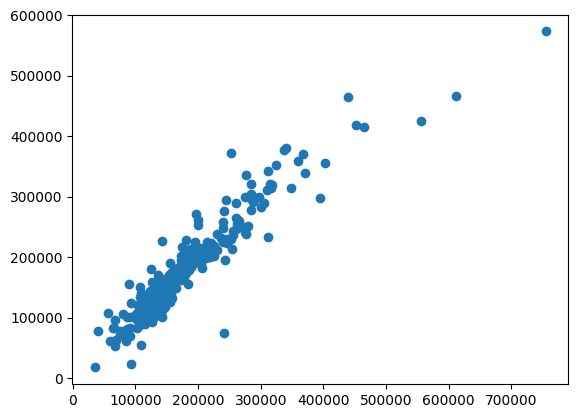

In [778]:
#Plotting the Y  test data to the Y  Prediction data 
plt.scatter(Y_test,y_predn)

Model Implementation and finding out theirR2 Score, Mean Squared Error, MEan Absolute Error, Cross Validation Scores
Models we will apply here are Linear Regression, Random Forest Regression, Gradient Boosting Regression
Random Forest is an ensemble technique that uses multiple of decision trees and can be used for both regression and classification tasks.

Linear Regression
Linear Regression predicts the final output-dependent value based on the given independent features. 

In [812]:
#Linear Regression
lr = LinearRegression()
lr.fit(X_train, Y_train)
print("Linear Regression R^2 Score: ", lr.score(X_train, Y_train))
print("Linear Regression Test R^2 Score: ", lr.score(X_test, Y_test))
y_pred = lr.predict(X_test)
print("Mean Squared Error: ", mean_squared_error(y_pred, Y_test))
print("Mean Absolute Error: ", mean_absolute_error(y_pred, Y_test))
print("Cross Validation Score: ", cross_val_score(lr, X_test, Y_test, cv=5))

Linear Regression R^2 Score:  0.9342354040825057
Linear Regression Test R^2 Score:  0.8845473433906528
Mean Squared Error:  885559537.6800516
Mean Absolute Error:  18400.41349787215
Cross Validation Score:  [ 0.06708539  0.42567396  0.69604012 -3.19451993 -0.31744178]


In [806]:
#Random Forest Regression
rfr = RandomForestRegressor(n_estimators=1000, max_depth=5, n_jobs=-1, random_state=12)
rfr.fit(X_train, Y_train)
print("Random Forest R^2 Score: ", rfr.score(X_train, Y_train))
print("Random Forest Test R^2 Score: ", rfr.score(X_test, Y_test))
y_pred = rfr.predict(X_test)
print("Mean Squared Error: ", mean_squared_error(y_pred, Y_test))
print("Mean Absolute Error: ", mean_absolute_error(y_pred, Y_test))
print("Cross Validation Score: ", cross_val_score(rfr, X_test, Y_test, cv=5))

Random Forest R^2 Score:  0.9078513189252693
Random Forest Test R^2 Score:  0.8611993569560921
Mean Squared Error:  1064646209.9141121
Mean Absolute Error:  20712.312829674356
Cross Validation Score:  [0.84417471 0.82906977 0.79668111 0.74747358 0.90031717]


In [807]:
#Gradient Boosting Regression
gbr = GradientBoostingRegressor(n_estimators=1000, max_depth=5, random_state=22)
gbr.fit(X_train, Y_train)
print("Gradient Boosting R^2 Score: ", gbr.score(X_train, Y_train))
print("Gradient Boosting Test R^2 Score: ", gbr.score(X_test, Y_test))
y_pred = gbr.predict(X_test)
print("Mean Squared Error: ", mean_squared_error(y_pred, Y_test))
print("Mean Absolute Error: ", mean_absolute_error(y_pred, Y_test))
print("Cross Validation Score: ", cross_val_score(gbr, X_test, Y_test, cv=5))

Gradient Boosting R^2 Score:  0.9999984466808033
Gradient Boosting Test R^2 Score:  0.9132979127944371
Mean Squared Error:  665033291.7106531
Mean Absolute Error:  15735.368632786694
Cross Validation Score:  [0.8194768  0.8061643  0.86965505 0.76854523 0.87369638]


Gradient Boosting is the highest performing model amongst all used with the accuracy of 99.99% on the training dataset and 91.3% on the testing dataset. We use GridSearchCV for the hyperparameter tuning of our model parameters.

In [819]:
#Hyperparameter Tuning
params = {'n_estimators':[500, 1000], 'max_depth':[3, 5, 8]}
gbr = GradientBoostingRegressor()
gbr_grid = GridSearchCV(gbr, params, cv=5)
gbr_grid.fit(X_train, Y_train)
print("Grid Search Gradient Boosting Score: ", gbr_grid.score(X_train, Y_train))
print("Grid Search Gradient Boosting Test Score: ", gbr_grid.score(X_test, Y_test))
print("Grid Search Gradient Boosting Best Parameters: ", gbr_grid.best_params_)

Grid Search Gradient Boosting Score:  0.994787692774748
Grid Search Gradient Boosting Test Score:  0.8897482378332181
Grid Search Gradient Boosting Best Parameters:  {'max_depth': 3, 'n_estimators': 500}


In [810]:
#K Nearest Neighbors
knr = KNeighborsRegressor(weights='distance', n_neighbors=200)
knr.fit(X_train, Y_train)
print("KNN Score: ", knr.score(X_train, Y_train))
print("KNN Test Score: ", knr.score(X_test, Y_test))

KNN Score:  1.0
KNN Test Score:  0.3803305131908731


Conclusion
In conclusion, Gradient Boosting is the most accurate model with this dataset.

In [816]:
#Alternate Method to find the accuracy of the models by developing a function
models = [LinearRegression(), RandomForestRegressor(n_estimators=1000),GradientBoostingRegressor(n_estimators=1000)]
def compare_models_cross_validation():
    for model in models:
        cv_score = cross_val_score(model, X, Y, cv=5)
        mean_accuracy = sum(cv_score)/len(cv_score)
        mean_accuracy = mean_accuracy*100
        mean_accuracy = round(mean_accuracy,2)
        print("Cross Validation Accuracies for the", model, '=', cv_score)
        print("Accuracy Score Of the ", model,'=',mean_accuracy,'%')
        print('-----------------------------------------------------------------------------------------------')

In [817]:
compare_models_cross_validation()

Cross Validation Accuracies for the LinearRegression() = [0.85127227 0.8201003  0.81166254 0.88708238 0.67662949]
Accuracy Score Of the  LinearRegression() = 80.93 %
-----------------------------------------------------------------------------------------------
Cross Validation Accuracies for the RandomForestRegressor(n_estimators=1000) = [0.86885768 0.84383954 0.87404614 0.88361958 0.81519719]
Accuracy Score Of the  RandomForestRegressor(n_estimators=1000) = 85.71 %
-----------------------------------------------------------------------------------------------
Cross Validation Accuracies for the GradientBoostingRegressor(n_estimators=1000) = [0.90977862 0.84642131 0.90397377 0.90545639 0.87904727]
Accuracy Score Of the  GradientBoostingRegressor(n_estimators=1000) = 88.89 %
-----------------------------------------------------------------------------------------------


**So we find that the Gradient Boosting Regressor is the most accurate model**